In [1]:
!pip install nibabel > /dev/null 2>&1
!pip  install celluloid > /dev/null 2>&1
!pip install pytorch-lightning > /dev/null 2>&1
!pip install imgaug > /dev/null 2>&1

In [2]:
!pip install torchsummary > /dev/null 2>&1


In [3]:
from pathlib import Path
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt
from celluloid import Camera
from IPython.display import HTML
import cv2
import warnings
warnings.filterwarnings('ignore')


In [4]:
# Define images and label path
path='/kaggle/input/azed-lung-cancer-dataset/Task06_Lung'
root = Path(f'{path}/imagesTr/')
label = Path(f'{path}/labelsTr/')

In [5]:
print("root:",root)
print("label:",label)


root: /kaggle/input/azed-lung-cancer-dataset/Task06_Lung/imagesTr
label: /kaggle/input/azed-lung-cancer-dataset/Task06_Lung/labelsTr


In [6]:
# Define function to replace imagesTr with labelsTr
def images_to_labels(path):
    parts = list(path.parts)
    parts[parts.index("imagesTr")] = "labelsTr"
    return Path(*parts)

In [7]:
# Select a patient to view
sample_patient_path = list(root.glob("lung_*"))[5]
sample_patient_label = images_to_labels(sample_patient_path)

In [8]:
print(sample_patient_path)
print(sample_patient_label)

/kaggle/input/azed-lung-cancer-dataset/Task06_Lung/imagesTr/lung_059.nii
/kaggle/input/azed-lung-cancer-dataset/Task06_Lung/labelsTr/lung_059.nii


In [9]:
data = nib.load(sample_patient_path)
label = nib.load(sample_patient_label)

In [10]:
print(data.shape)
print(label.shape)

(512, 512, 218)
(512, 512, 218)


In [11]:
ct = data.get_fdata()
mask = label.get_fdata()

In [12]:
print(ct.shape)
print(mask.shape)

(512, 512, 218)
(512, 512, 218)


In [13]:
nib.aff2axcodes(data.affine)

('L', 'A', 'S')

In [14]:
# Création d'une animation des coupes avec masques
fig = plt.figure()
camera = Camera(fig)

for i in range(0, ct.shape[2], 2):
    plt.imshow(ct[:,:,i], cmap="bone")
    mask_ = np.ma.masked_where(mask[:,:,i]==0, mask[:,:,i])
    plt.imshow(mask_, alpha=0.5, cmap="autumn")
    camera.snap()

animation = camera.animate(interval=50)  # Intervalle de 50 ms entre les frames
plt.close()
HTML(animation.to_jshtml())  # Afficher l'animation dans un notebook


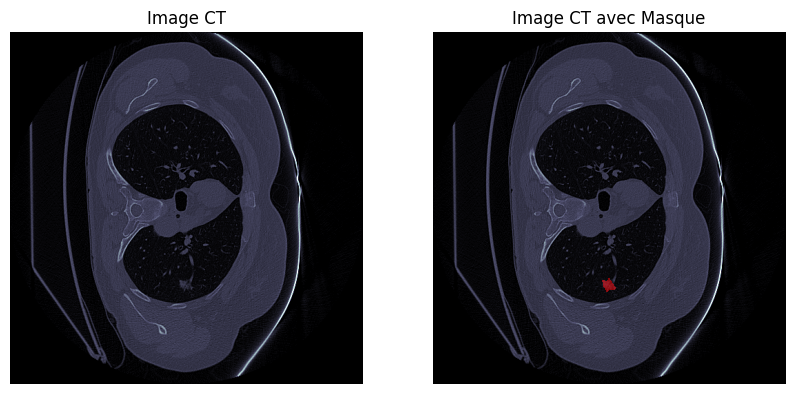

In [15]:
# Chercher une tranche où le masque n'est pas vide
for i in range(ct.shape[2]):
    if np.any(mask[:, :, i]):  # Si le masque contient des valeurs non nulles
        break  # On a trouvé la tranche à afficher

# Affichage de l'image CT et du masque correspondant
plt.figure(figsize=(10, 5))

# Image CT
plt.subplot(1, 2, 1)
plt.imshow(ct[:, :, i+5], cmap="bone")
plt.title("Image CT")
plt.axis('off')

# Image CT avec Masque
plt.subplot(1, 2, 2)
mask_ = np.ma.masked_where(mask[:, :, i+5] == 0, mask[:, :, i+5])
plt.imshow(ct[:, :, i+5], cmap="bone")
plt.imshow(mask_, alpha=0.5, cmap="autumn")
plt.title("Image CT avec Masque")
plt.axis('off')

plt.show()


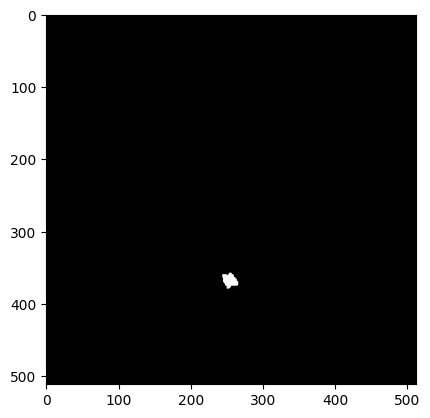

In [16]:
plt.imshow(mask[:, :, i+5], cmap="gray")

In [17]:
import cv2
import numpy as np
import nibabel as nib
from pathlib import Path
from tqdm import tqdm

In [18]:
def preprocess(root, save_root):
    # Get a list of all files with names starting with "lung_*"
    all_files = list(root.glob("lung_*"))
    
    # Use tqdm to wrap the loop over scans for progress bar
    for scan, ct_scan_path in enumerate(tqdm(all_files, desc="Processing scans")):
        ct_label_path = images_to_labels(ct_scan_path)
        ct_scan_data = nib.load(ct_scan_path).get_fdata()
        ct_label_data = nib.load(ct_label_path).get_fdata()
        ct_scan_data = ct_scan_data[:, :, 30:] / 3071
        ct_label_data = ct_label_data[:, :, 30:]

        # Determine if the current scan goes to the training or validation set
        if scan < 55:
            current_path = save_root / "train" / str(scan)
        else:
            current_path = save_root / "val" / str(scan)
        
        # Loop over the slices in the CT scan
        for i in range(ct_scan_data.shape[-1]):
            slice = ct_scan_data[:, :, i]
            mask = ct_label_data[:, :, i]
            slice = cv2.resize(slice, (256, 256))
            mask = cv2.resize(mask, (256, 256), interpolation=cv2.INTER_NEAREST)
            slice_path = current_path / "data"
            mask_path = current_path / "masks"
            slice_path.mkdir(parents=True, exist_ok=True)
            mask_path.mkdir(parents=True, exist_ok=True)
            np.save(slice_path / str(i), slice)
            np.save(mask_path / str(i), mask)


In [77]:
#import  glob
#files = glob.glob('/kaggle/working/epoch*')

# Supprime chaque fichier trouvé
##for file in files:
    os.remove(file)

In [78]:
import shutil

# Supprime le dossier '/kaggle/working/new_data'
#shutil.rmtree('/kaggle/working/epoch=18-val_loss=0.00.ckpt')

In [20]:
save_root = Path("/kaggle/working/new_data")
preprocess(root, save_root)


Processing scans: 100%|██████████| 63/63 [05:21<00:00,  5.10s/it]


In [21]:
path = Path(f"{save_root}/train/54")  
list(path.glob("*"))

[PosixPath('/kaggle/working/new_data/train/54/data'),
 PosixPath('/kaggle/working/new_data/train/54/masks')]

In [22]:
file="123.npy"
slice = np.load(path/"data"/file)
mask = np.load(path/"masks"/file)

In [23]:
print(slice.shape)
mask.shape

(256, 256)


(256, 256)

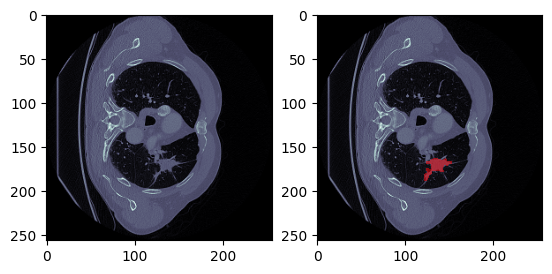

In [24]:
fig, axis = plt.subplots(1, 2)
axis[0].imshow(slice, cmap="bone")
mask_ = np.ma.masked_where(mask==0, mask)
axis[1].imshow(slice, cmap="bone")
axis[1].imshow(mask_, alpha=0.5, cmap="autumn")


# =============================================================================

In [25]:
import torch
import numpy as np
import imgaug
import imgaug.augmenters as iaa
from imgaug.augmentables.segmaps import SegmentationMapsOnImage
from pathlib import Path
import matplotlib.pyplot as plt


class LungDataset(torch.utils.data.Dataset):
    def __init__(self, root, aug):
        self.all_files = self.extract_files(root)
        self.aug = aug

    @staticmethod
    def extract_files(root):
        files = []
        for subject in root.glob("*"):
            slice_path = subject/"data"
            for slice in slice_path.glob("*.npy"):
                files.append(slice)
        return files
    
    @staticmethod
    def images_to_labels(path):
        parts = list(path.parts)
        parts[parts.index("data")] = "masks"
        return Path(*parts)

    def augment(self, slice, mask):
        random_seed = torch.randint(0, 1000000, (1,)).item() 
        imgaug.seed(random_seed)
        mask = SegmentationMapsOnImage(mask, mask.shape)
        slice_aug, mask_aug = self.aug(image=slice, segmentation_maps=mask)
        mask_aug = mask_aug.get_arr()
        return slice_aug, mask_aug

    def __len__(self):
        return len(self.all_files)

    def __getitem__(self, idx):
        file_path = self.all_files[idx]
        mask_path = self.images_to_labels(file_path)
        slice = np.load(file_path).astype(np.float32) 
        mask = np.load(mask_path).astype(np.int32)

        if self.aug:
            slice, mask = self.augment(slice, mask)
        
        return np.expand_dims(slice, 0), np.expand_dims(mask, 0)

# =============================================================================

In [26]:
import torch

class DoubleConvBlock(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        # Define a sequence of two convolutional layers followed by ReLU activation.
        self.step = torch.nn.Sequential(
            torch.nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            torch.nn.ReLU(),
            torch.nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            torch.nn.ReLU()
        )

    def forward(self, X):
        # Pass the input tensor through the sequence of layers.
        return self.step(X)

class UNet(torch.nn.Module):
    def __init__(self):
        super().__init__()
        
        # Define the encoder part of the UNet with four DoubleConvBlock layers.
        self.layer1 = DoubleConvBlock(1, 64)
        self.layer2 = DoubleConvBlock(64, 128)
        self.layer3 = DoubleConvBlock(128, 256)
        self.layer4 = DoubleConvBlock(256, 512)

        # Define the decoder part of the UNet with three DoubleConvBlock layers.
        # The input channels for each layer are the concatenation of the output of the previous decoder layer and the corresponding encoder layer.
        self.layer5 = DoubleConvBlock(512 + 256, 256)
        self.layer6 = DoubleConvBlock(256 + 128, 128)
        self.layer7 = DoubleConvBlock(128 + 64, 64)

        # Final 1x1 convolutional layer to produce the output segmentation mask.
        self.layer8 = torch.nn.Conv2d(64, 1, 1)

        # Max pooling layer with kernel size 2 and stride 2 to downsample the feature maps.
        self.maxpool = torch.nn.MaxPool2d(2)

    def forward(self, x):
        # Encoder part of the UNet:
        x1 = self.layer1(x)
        x1_m = self.maxpool(x1)

        x2 = self.layer2(x1_m)
        x2_m = self.maxpool(x2)

        x3 = self.layer3(x2_m)
        x3_m = self.maxpool(x3)

        x4 = self.layer4(x3_m)

        # Decoder part of the UNet with upsampling using bilinear interpolation (Upsample) and concatenation of skip connections.
        x5 = torch.nn.Upsample(scale_factor=2, mode="bilinear")(x4)
        x5 = torch.cat([x5, x3], dim=1) # Skip-connection
        x5 = self.layer5(x5)

        x6 = torch.nn.Upsample(scale_factor=2, mode="bilinear")(x5)
        x6 = torch.cat([x6, x2], dim=1) # Skip-connection
        x6 = self.layer6(x6)

        x7 = torch.nn.Upsample(scale_factor=2, mode="bilinear")(x6)
        x7 = torch.cat([x7, x1], dim=1) # Skip-connection
        x7 = self.layer7(x7)

        # Final 1x1 convolutional layer to produce the output segmentation mask.
        return self.layer8(x7)

In [27]:
from torchsummary import summary

# Créez une instance de votre modèle UNet
model = UNet()

# Déplacez le modèle sur le bon appareil (CPU ou GPU)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Affichez le résumé du modèle avec une taille d'entrée (exemple : 1 canal, 256x256)
summary(model, input_size=(1, 256, 256))


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]             640
              ReLU-2         [-1, 64, 256, 256]               0
            Conv2d-3         [-1, 64, 256, 256]          36,928
              ReLU-4         [-1, 64, 256, 256]               0
   DoubleConvBlock-5         [-1, 64, 256, 256]               0
         MaxPool2d-6         [-1, 64, 128, 128]               0
            Conv2d-7        [-1, 128, 128, 128]          73,856
              ReLU-8        [-1, 128, 128, 128]               0
            Conv2d-9        [-1, 128, 128, 128]         147,584
             ReLU-10        [-1, 128, 128, 128]               0
  DoubleConvBlock-11        [-1, 128, 128, 128]               0
        MaxPool2d-12          [-1, 128, 64, 64]               0
           Conv2d-13          [-1, 256, 64, 64]         295,168
             ReLU-14          [-1, 256,

# =============================================================================

In [28]:
import torch
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint
from pytorch_lightning.loggers import TensorBoardLogger
import imgaug.augmenters as iaa

import sklearn.metrics as metrics
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path

from celluloid import Camera
from IPython.display import HTML



import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

In [29]:
# Define data augmentations
seq = iaa.Sequential([
    iaa.Affine(scale=(0.85, 1.15),
    rotate=(-45, 45)),
    iaa.ElasticTransformation()
])

In [30]:
train_path = Path('/kaggle/working/new_data/train/')
val_path = Path('/kaggle/working/new_data/val/')

In [31]:
train_dataset = LungDataset(train_path, seq)
val_dataset = LungDataset(val_path, None)


In [32]:
target_list = []
for _, label in train_dataset:
    # Check if mask contains a tumorous pixel:
    if np.any(label):
        target_list.append(1)
    else:
        target_list.append(0)

unique = np.unique(target_list, return_counts=True)
ratio = unique[1][0] / unique[1][1]
ratio

8.49000689179876

In [33]:
unique

(array([0, 1]), array([12319,  1451]))

In [34]:
weight_list = []

for target in target_list:
    if target == 0:
        weight_list.append(1)
    else:
        weight_list.append(ratio)

In [35]:
sampler = torch.utils.data.sampler.WeightedRandomSampler(weight_list, len(weight_list))


In [36]:
# Define variables
batch_size = 8
num_workers = 4

# Create data loaders
train_loader = torch.utils.data.DataLoader(
    train_dataset,
    batch_size=batch_size,
    num_workers=num_workers,
    sampler=sampler
)

val_loader = torch.utils.data.DataLoader(
    val_dataset,
    batch_size=batch_size,
    num_workers=num_workers,
    shuffle=False
)

In [110]:
# Define the TumorSegmentation class as a LightningModule
class TumorSegmentation(pl.LightningModule):
    def __init__(self):
        super().__init__()

        # Create an instance of the UNet model
        self.model = UNet()

        # Define the Adam optimizer for model parameters with a learning rate of 1e-4
        self.optimizer = torch.optim.Adam(self.model.parameters(), lr=1e-4)

        # Define the loss function for binary classification with logits
        self.loss_fn = torch.nn.BCEWithLogitsLoss()

    # Define the forward pass of the model
    def forward(self, data):
        pred = self.model(data)
        return pred

    # Define the training step for the LightningModule
    def training_step(self, batch, batch_idx):
        # Unpack the batch into CT scan images and their corresponding masks
        ct_scan, mask = batch
        mask = mask.float()

        # Perform the forward pass to get the model predictions
        pred = self(ct_scan)

        # Calculate the binary cross-entropy loss between predictions and masks
        loss = self.loss_fn(pred, mask)

        # Log the loss and images periodically during training
        self.log("Train Loss", loss)
        if batch_idx % 50 == 0:
            self.log_images(ct_scan.cpu(), pred.cpu(), mask.cpu(), "Train")

        return loss

    # Define the validation step for the LightningModule
    def validation_step(self, batch, batch_idx):
        # Unpack the batch into CT scan images and their corresponding masks
        ct_scan, mask = batch
        mask = mask.float()

        # Perform the forward pass to get the model predictions
        pred = self(ct_scan)

        # Calculate the binary cross-entropy loss between predictions and masks
        loss = self.loss_fn(pred, mask)

        # Log the loss and images periodically during validation
        self.log("Val Loss", loss)
        if batch_idx % 50 == 0:
            self.log_images(ct_scan.cpu(), pred.cpu(), mask.cpu(), "Val")

        return loss

    # Define a method to log CT scan images, actual masks, and predicted masks
    def log_images(self, ct_scan, pred, mask, name):
        results = []

        # Threshold the predicted masks to obtain binary masks
        pred = pred > 0.5

        # Create a figure with two subplots to display actual and predicted masks
        fig, axis = plt.subplots(1, 2)
        axis[0].imshow(ct_scan[0][0], cmap="bone")
        mask_ = np.ma.masked_where(mask[0][0] == 0, mask[0][0])
        axis[0].imshow(mask_, alpha=0.6)
        axis[0].set_title("Actual")

        axis[1].imshow(ct_scan[0][0], cmap="bone")
        mask_ = np.ma.masked_where(mask[0][0] == 0, mask[0][0])
        axis[1].imshow(mask_, alpha=0.6)
        axis[1].set_title("Predicted")

        # Add the figure to the experiment's logger for visualization
        self.logger.experiment.add_figure(f"{name} Actual vs Prediction", fig, self.global_step)

    # Define a method to configure the optimizer
    def configure_optimizers(self):
        return [self.optimizer]

In [113]:
# Create checkpoint
checkpoint_callback = ModelCheckpoint(
    monitor='Val Loss',
    save_top_k=1,
    mode='min'
)

In [114]:
model = TumorSegmentation()


In [115]:
# Create PyTorch Lightning Trainer
trainer = pl.Trainer(
    devices=1,
    accelerator='gpu',
    logger=TensorBoardLogger(save_dir='/kaggle/working/logs'),
    log_every_n_steps=1,
    callbacks=checkpoint_callback,
    max_epochs=30
)

In [ ]:
# Train model
trainer.fit(model, train_loader, val_loader)

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

In [80]:
import os
import torch
import pytorch_lightning as pl
from pytorch_lightning.loggers import CSVLogger
from pytorch_lightning.callbacks import ModelCheckpoint, EarlyStopping
from torchmetrics import Precision, Recall
import matplotlib.pyplot as plt

# Fonction pour calculer le coefficient de Dice
def dice_coefficient(pred, target):
    pred = torch.sigmoid(pred) > 0.5
    intersection = (pred * target).sum()
    union = pred.sum() + target.sum()
    dice = 2.0 * intersection / (union + 1e-6)
    return dice

# Fonction pour calculer l'IoU
def iou(pred, target):
    pred = torch.sigmoid(pred) > 0.5
    intersection = (pred * target).sum()
    union = (pred + target).sum() - intersection
    iou = intersection / (union + 1e-6)
    return iou

class TumorSegmentation(pl.LightningModule):
    def __init__(self):
        super().__init__()

        self.model = UNet()
        self.optimizer = torch.optim.Adam(self.model.parameters(), lr=1e-4)
        self.loss_fn = torch.nn.BCEWithLogitsLoss()

        # Ajout des métriques
        self.train_precision = Precision(task='binary')
        self.val_precision = Precision(task='binary')
        self.train_recall = Recall(task='binary')
        self.val_recall = Recall(task='binary')

    def forward(self, data):
        pred = self.model(data)
        return pred

    def training_step(self, batch, batch_idx):
        ct_scan, mask = batch
        mask = mask.float()

        pred = self(ct_scan)
        loss = self.loss_fn(pred, mask)

        # Calcul des métriques
        train_dice = dice_coefficient(pred, mask)
        train_iou = iou(pred, mask)
        train_precision = self.train_precision(pred, mask.int())
        train_recall = self.train_recall(pred, mask.int())

        # Enregistrement des métriques
        self.log("loss", loss, prog_bar=True)
        self.log("dice_coefficient", train_dice, prog_bar=True)
        self.log("iou", train_iou, prog_bar=True)
        self.log("precision", train_precision, prog_bar=True)
        self.log("recall", train_recall, prog_bar=True)

        return loss

    def validation_step(self, batch, batch_idx):
        ct_scan, mask = batch
        mask = mask.float()

        pred = self(ct_scan)
        loss = self.loss_fn(pred, mask)

        # Calcul des métriques
        val_dice = dice_coefficient(pred, mask)
        val_iou = iou(pred, mask)
        val_precision = self.val_precision(pred, mask.int())
        val_recall = self.val_recall(pred, mask.int())

        # Enregistrement des métriques
        self.log("val_loss", loss, prog_bar=True)
        self.log("val_dice_coefficient", val_dice, prog_bar=True)
        self.log("val_iou", val_iou, prog_bar=True)
        self.log("val_precision", val_precision, prog_bar=True)
        self.log("val_recall", val_recall, prog_bar=True)

        return loss

    def configure_optimizers(self):
        return [self.optimizer]

# Configuration du callback pour sauvegarder uniquement le meilleur modèle
checkpoint_callback = ModelCheckpoint(
    monitor='val_loss',
    save_top_k=1,  # Sauvegarder uniquement le meilleur modèle
    mode='min',
    dirpath='/kaggle/working/',  # Emplacement pour les checkpoints
    filename='best_model'  # Nom du fichier
)

# Configuration du logger pour sauvegarder les métriques dans un fichier CSV
csv_logger = CSVLogger(save_dir='/kaggle/working/', name='metrics_logs')

# Configuration du callback EarlyStopping
early_stopping_callback = EarlyStopping(
    monitor='val_loss',
    patience=10,
    mode='min'
)

# Initialisation du modèle
model = TumorSegmentation()

# Configuration du Trainer PyTorch Lightning
trainer = pl.Trainer(
    max_epochs=30,
    logger=csv_logger,  # Enregistrement des logs dans le CSV
    callbacks=[checkpoint_callback, early_stopping_callback],
    log_every_n_steps=1,
    accelerator='gpu',
    devices=1
)

# Entraînement du modèle
trainer.fit(model, train_loader, val_loader)




Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

In [81]:
# Charger le fichier CSV
csv_path = "/kaggle/working/metrics_logs/version_1/metrics.csv"  # Chemin vers votre fichier CSV
data = pd.read_csv(csv_path,)

In [86]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
dice_coefficient,27552.0,0.725345,0.283709,0.000000e+00,0.715579,0.843596,0.896667,0.976471
epoch,27568.0,7.500000,4.609856,0.000000e+00,3.750000,7.500000,11.250000,15.000000
iou,27552.0,0.627943,0.268180,0.000000e+00,0.557121,0.729499,0.812690,0.954023
loss,27552.0,0.002844,0.015652,6.400330e-07,0.000880,0.001420,0.002356,0.688228
precision,27552.0,0.787672,0.286268,0.000000e+00,0.817814,0.897534,0.937355,1.000000
recall,27552.0,0.694555,0.289971,0.000000e+00,0.635634,0.812320,0.889490,1.000000
step,27568.0,13775.999420,7953.739546,0.000000e+00,6887.750000,13775.500000,20663.250000,27551.000000
val_dice_coefficient,16.0,0.180880,0.051962,0.000000e+00,0.180773,0.195462,0.204727,0.222291
val_iou,16.0,0.144868,0.042727,0.000000e+00,0.143605,0.158199,0.167074,0.177513
val_loss,16.0,0.000877,0.000839,5.461458e-04,0.000608,0.000667,0.000707,0.003997


In [88]:
checkpoint_callback.best_model_path

'/kaggle/working/best_model.ckpt'

In [87]:
# Chargement du meilleur modèle après l'entraînement
best_model_path = checkpoint_callback.best_model_path
model = TumorSegmentation.load_from_checkpoint(best_model_path)

In [93]:
model.eval()

device = "mps" if torch.backends.mps.is_available() else "cpu"
model.to(device)

TumorSegmentation(
  (model): UNet(
    (layer1): DoubleConvBlock(
      (step): Sequential(
        (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU()
        (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (3): ReLU()
      )
    )
    (layer2): DoubleConvBlock(
      (step): Sequential(
        (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU()
        (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (3): ReLU()
      )
    )
    (layer3): DoubleConvBlock(
      (step): Sequential(
        (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): ReLU()
        (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (3): ReLU()
      )
    )
    (layer4): DoubleConvBlock(
      (step): Sequential(
        (0): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): 

In [94]:
# Classe pour évaluer le score de Dice
class DiceScore(torch.nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, pred, mask):
        pred = torch.flatten(pred)
        mask = torch.flatten(mask)

        intersection = (pred * mask).sum() 
        union = pred.sum() + mask.sum()
        dice = (2.0 * intersection) / union

        return dice

In [95]:

dice_score_calculator = DiceScore()
dice_scores = []

for slice, label in val_dataset:
    slice = torch.tensor(slice).float().to(device).unsqueeze(0)
    with torch.no_grad():
        pred = torch.sigmoid(model(slice))
    dice_score = dice_score_calculator(pred, torch.tensor(label).float().unsqueeze(0).to(device))
    dice_scores.append(dice_score.item())

average_dice_score = sum(dice_scores) / len(dice_scores)
print(f"The Val Dice Score is: {average_dice_score:.4f}")

The Val Dice Score is: 0.0417


In [109]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import nibabel as nib
import cv2
from matplotlib.animation import FuncAnimation
from pathlib import Path

# Charger le modèle après l'entraînement
model = TumorSegmentation.load_from_checkpoint("/kaggle/working/best_model.ckpt")
model.eval()
device = "mps" if torch.backends.mps.is_available() else "cpu"
model.to(device)

# Classe pour évaluer le score de Dice
class DiceScore(torch.nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, pred, mask):
        pred = torch.flatten(pred)
        mask = torch.flatten(mask)
        intersection = (pred * mask).sum() 
        union = pred.sum() + mask.sum()
        dice = (2.0 * intersection) / (union + 1e-6)
        return dice

# Classe pour évaluer l'IoU
class IoUScore(torch.nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, pred, mask):
        pred = torch.flatten(pred)
        mask = torch.flatten(mask)
        intersection = (pred * mask).sum()
        union = (pred + mask).sum() - intersection
        iou = intersection / (union + 1e-6)
        return iou

dice_score_calculator = DiceScore()
iou_score_calculator = IoUScore()

dice_scores, iou_scores, precisions, recalls = [], [], [], []

for slice, label in val_dataset:
    slice = torch.tensor(slice).float().to(device).unsqueeze(0)
    with torch.no_grad():
        pred = torch.sigmoid(model(slice))
    pred = pred > 0.5
    label = torch.tensor(label).float().unsqueeze(0).to(device)

    dice_score = dice_score_calculator(pred, label).item()
    iou_score = iou_score_calculator(pred, label).item()

    # Assumons que les fonctions de précision et de rappel sont calculées ailleurs
    # Ces lignes sont des placeholders pour la précision et le rappel
    precision = torch.sum(pred * label).float() / (torch.sum(pred).float() + 1e-6)
    recall = torch.sum(pred * label).float() / (torch.sum(label).float() + 1e-6)

    dice_scores.append(dice_score)
    iou_scores.append(iou_score)
    precisions.append(precision.item())
    recalls.append(recall.item())

average_dice_score = sum(dice_scores) / len(dice_scores)
average_iou_score = sum(iou_scores) / len(iou_scores)
average_precision = sum(precisions) / len(precisions)
average_recall = sum(recalls) / len(recalls)

print(f"The Val Dice Score is: {average_dice_score:.4f}")
print(f"The Val IoU Score is: {average_iou_score:.4f}")
print(f"The Val Precision is: {average_precision:.4f}")
print(f"The Val Recall is: {average_recall:.4f}")

The Val Dice Score is: 0.0417
The Val IoU Score is: 0.0347
The Val Precision is: 0.0525
The Val Recall is: 0.0379


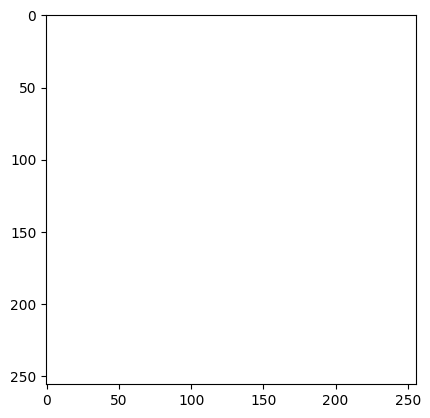

In [107]:
plt.imshow(mask[:, :, ], cmap="gray")

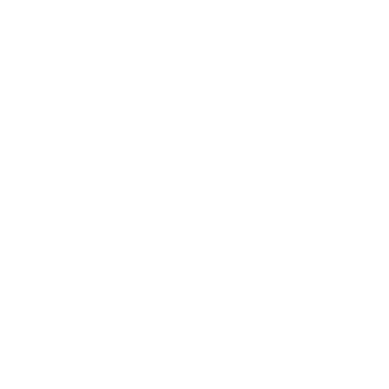

In [106]:
fig = plt.figure()
camera = Camera(fig)

for i in range(0, len(scan), 2): 
    plt.imshow(scan[i], cmap="bone")
    mask = np.ma.masked_where(segmentation[i]==0, segmentation[i])
    plt.imshow(mask, alpha=0.5, cmap="autumn")
    plt.axis("off")
    camera.snap()

animation = camera.animate()
HTML(animation.to_html5_video())

In [ ]:
def log_images(self, ct_scan, pred, mask, name, batch_idx):
    """Enregistre les images de CT scan, masques prédits et masques réels en tant que fichiers image."""

    # Sélectionner une image du lot
    ct_scan_ = ct_scan[0][0]  # Première image du lot, canal unique
    pred_ = pred[0][0]        # Première prédiction du lot, canal unique
    mask_ = mask[0][0]        # Premier masque du lot, canal unique

    fig, axis = plt.subplots(1, 3, figsize=(15, 5))
    axis[0].imshow(ct_scan_, cmap="gray")
    axis[0].set_title("Original")
    axis[1].imshow(pred_, cmap="gray", alpha=0.6)
    axis[1].set_title("Predicted")
    axis[2].imshow(mask_, cmap="gray", alpha=0.6)
    axis[2].set_title("Ground Truth")

    # Créer un dossier pour sauvegarder les images si nécessaire
    save_dir = os.path.join('/kaggle/working/', 'logged_images')
    os.makedirs(save_dir, exist_ok=True)

    # Nom de fichier basé sur l'epoch et le batch
    filename = os.path.join(save_dir, f"{name}_epoch{self.current_epoch}_batch{batch_idx}.png")

    # Sauvegarder la figure
    plt.savefig(filename)
    plt.close(fig)